Practice EDA project with scalling 

In [1]:
# importing the main libraries
import numpy as np 
import pandas as pd 
import matplotlib.pyplot as plt 
import seaborn as sns 
# import warning 
import warnings 
warnings.filterwarnings('ignore')
# import log create model log
import logging 
logging.basicConfig(
    level=logging.INFO,
    filename='model1.log',
    filemode='w',
    format= '%(asctime)s - %(levelname)s - %(message)s',
    force= True
)

In [2]:
# load  dataset with pandas library
df = pd.read_csv('dataset_phishing.csv')
df


,url,length_url,length_hostname,ip,nb_dots,nb_hyphens,nb_at,nb_qm,nb_and,nb_or,...,domain_in_title,domain_with_copyright,whois_registered_domain,domain_registration_length,domain_age,web_traffic,dns_record,google_index,page_rank,status
0,http://www.crestonwood.com/router.php,37,19,0,3,0,0,0,0,0,...,0,1,0,45,-1,0,1,1,4,legitimate
1,http://shadetreetechnology.com/V4/validation/a...,77,23,1,1,0,0,0,0,0,...,1,0,0,77,5767,0,0,1,2,phishing
2,https://support-appleld.com.secureupdate.duila...,126,50,1,4,1,0,1,2,0,...,1,0,0,14,4004,5828815,0,1,0,phishing
3,http://rgipt.ac.in,18,11,0,2,0,0,0,0,0,...,1,0,0,62,-1,107721,0,0,3,legitimate
4,http://www.iracing.com/tracks/gateway-motorspo...,55,15,0,2,2,0,0,0,0,...,0,1,0,224,8175,8725,0,0,6,legitimate
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11425,http://www.fontspace.com/category/blackletter,45,17,0,2,0,0,0,0,0,...,0,0,0,448,5396,3980,0,0,6,legitimate
11426,http://www.budgetbots.com/server.php/Server%20...,84,18,0,5,0,1,1,0,0,...,1,0,0,211,6728,0,0,1,0,phishing
11427,https://www.facebook.com/Interactive-Televisio...,105,16,1,2,6,0,1,0,0,...,0,0,0,2809,8515,8,0,1,10,legitimate
11428,http://www.mypublicdomainpictures.com/,38,30,0,2,0,0,0,0,0,...,1,0,0,85,2836,2455493,0,0,4,legitimate


In [3]:
df.sample(frac=1)

,url,length_url,length_hostname,ip,nb_dots,nb_hyphens,nb_at,nb_qm,nb_and,nb_or,...,domain_in_title,domain_with_copyright,whois_registered_domain,domain_registration_length,domain_age,web_traffic,dns_record,google_index,page_rank,status
4900,http://lp2m.umsu.ac.id/wp-includes/IXR/redirec...,52,15,0,4,1,0,0,0,0,...,1,0,0,830,8294,150140,0,1,2,phishing
223,http://www.neudorf-ole.irv.cc/4B374AA12276932A...,86,22,1,3,1,0,1,0,0,...,1,0,0,18,5826,0,0,1,0,phishing
6261,http://firstgradewow.blogspot.com,33,26,0,2,0,0,0,0,0,...,1,0,0,373,7296,875896,0,0,5,legitimate
10197,http://www.automatemyhome.com/wp-includes/font...,84,22,0,4,1,0,0,0,0,...,0,0,0,15,6559,0,0,1,2,phishing
11062,http://cn2.lynmaxonline.com/source,34,20,0,2,0,0,0,0,0,...,1,0,0,178,-1,0,0,1,0,phishing
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9671,http://support-appleld.com.secureupdate.duilaw...,76,50,1,4,1,0,0,0,0,...,1,0,0,15,4003,5816617,0,1,0,phishing
6535,https://msdn.microsoft.com/en-us/library/windo...,79,18,1,4,1,0,0,0,0,...,0,0,0,282,10676,23,0,1,8,legitimate
716,http://carryco.com/blog/profile/control.html,44,11,0,2,0,0,0,0,0,...,1,0,0,1752,3727,0,0,1,0,phishing
10793,http://mintandchopsticks.com/wp-includes/image...,67,21,0,1,1,0,0,0,0,...,0,1,0,290,2996,0,0,1,0,phishing


In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 11430 entries, 0 to 11429
Data columns (total 89 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   url                         11430 non-null  object 
 1   length_url                  11430 non-null  int64  
 2   length_hostname             11430 non-null  int64  
 3   ip                          11430 non-null  int64  
 4   nb_dots                     11430 non-null  int64  
 5   nb_hyphens                  11430 non-null  int64  
 6   nb_at                       11430 non-null  int64  
 7   nb_qm                       11430 non-null  int64  
 8   nb_and                      11430 non-null  int64  
 9   nb_or                       11430 non-null  int64  
 10  nb_eq                       11430 non-null  int64  
 11  nb_underscore               11430 non-null  int64  
 12  nb_tilde                    11430 non-null  int64  
 13  nb_percent                  114

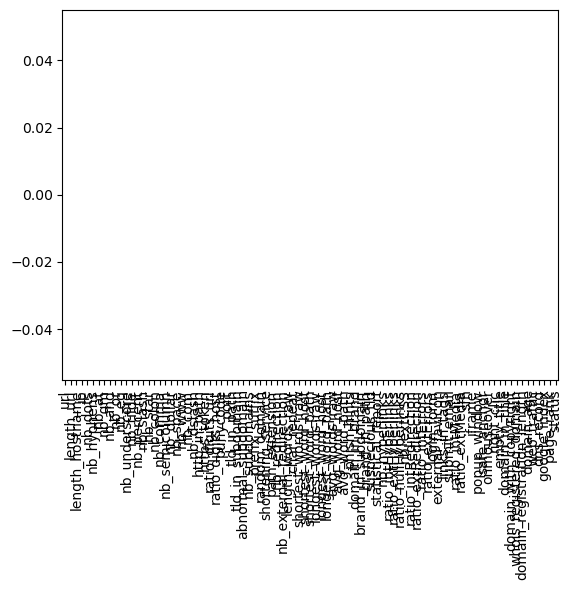

In [5]:
# checking the null values in the dataset
df.isnull().sum().plot(kind='bar')
plt.show() # not any null value present in there


In [6]:
# Segregate the categorical and numerical columns 
categorical_col= df.select_dtypes(include='object')
numerical_cal=df.select_dtypes(exclude='object')
categorical_col
numerical_cal

,length_url,length_hostname,ip,nb_dots,nb_hyphens,nb_at,nb_qm,nb_and,nb_or,nb_eq,...,empty_title,domain_in_title,domain_with_copyright,whois_registered_domain,domain_registration_length,domain_age,web_traffic,dns_record,google_index,page_rank
0,37,19,0,3,0,0,0,0,0,0,...,0,0,1,0,45,-1,0,1,1,4
1,77,23,1,1,0,0,0,0,0,0,...,0,1,0,0,77,5767,0,0,1,2
2,126,50,1,4,1,0,1,2,0,3,...,0,1,0,0,14,4004,5828815,0,1,0
3,18,11,0,2,0,0,0,0,0,0,...,0,1,0,0,62,-1,107721,0,0,3
4,55,15,0,2,2,0,0,0,0,0,...,0,0,1,0,224,8175,8725,0,0,6
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11425,45,17,0,2,0,0,0,0,0,0,...,0,0,0,0,448,5396,3980,0,0,6
11426,84,18,0,5,0,1,1,0,0,1,...,0,1,0,0,211,6728,0,0,1,0
11427,105,16,1,2,6,0,1,0,0,1,...,0,0,0,0,2809,8515,8,0,1,10
11428,38,30,0,2,0,0,0,0,0,0,...,0,1,0,0,85,2836,2455493,0,0,4


In [17]:
# EDA : CHECKING MEAN MEDIAN , IQR VALUES
from collections import OrderedDict
stats=[]
for  i in df.select_dtypes(include=['number']).columns:
    numerical_stats = OrderedDict({
        'feature':i,
        'Count':df[i].count(),
        'Mean' :df[i].mean(),
        'Median' :df[i].median(),
        'Minimum': df[i].min(),
        'Maximum' : df[i].max(),
        'Range' : df[i].max()- df[i].min(),
        'Q1' : df[i].quantile(0.25),
        'Q3':df[i].quantile(0.75),
        'IQR' : df[i].quantile(0.75)-df[i].quantile(0.25)
        
    })
    stats.append(numerical_stats)
    report = pd.DataFrame(stats)
report['IQR'].value_counts(ascending=False)

IQR
0.000000         49
1.000000         11
3.000000          3
6.000000          2
38.000000         1
0.474840          1
373845.500000     1
6054.500000       1
365.000000        1
75.000000         1
33.333333         1
100.000000        1
98.061004         1
0.034483          1
0.230769          1
92.000000         1
0.719776          1
9.000000          1
6.714286          1
3.750000          1
2.750000          1
11.000000         1
7.000000          1
0.079365          1
2.000000          1
4.000000          1
Name: count, dtype: int64

In [9]:
import pandas as pd
pd.set_option('display.max_rows',None)
pd.set_option('display.max_column',None)
#CHECK IQR == 0
report[report ['IQR'] == 0]['feature'].values

array(['ip', 'nb_at', 'nb_qm', 'nb_and', 'nb_or', 'nb_eq',
       'nb_underscore', 'nb_tilde', 'nb_percent', 'nb_star', 'nb_colon',
       'nb_comma', 'nb_semicolumn', 'nb_dollar', 'nb_space', 'nb_com',
       'nb_dslash', 'http_in_path', 'ratio_digits_host', 'punycode',
       'port', 'tld_in_path', 'tld_in_subdomain', 'abnormal_subdomain',
       'prefix_suffix', 'random_domain', 'shortening_service',
       'path_extension', 'nb_external_redirection', 'phish_hints',
       'domain_in_brand', 'brand_in_subdomain', 'brand_in_path',
       'suspecious_tld', 'statistical_report', 'ratio_nullHyperlinks',
       'ratio_intRedirection', 'ratio_intErrors', 'login_form',
       'submit_email', 'sfh', 'iframe', 'popup_window', 'onmouseover',
       'right_clic', 'empty_title', 'domain_in_title',
       'whois_registered_domain', 'dns_record'], dtype=object)

In [24]:
df.drop(columns=['ip', 'nb_at', 'nb_qm', 'nb_and', 'nb_or', 'nb_eq',
       'nb_underscore', 'nb_tilde', 'nb_percent', 'nb_star', 'nb_colon',
       'nb_comma', 'nb_semicolumn', 'nb_dollar', 'nb_space', 'nb_com',
       'nb_dslash', 'http_in_path', 'ratio_digits_host', 'punycode',
       'port', 'tld_in_path', 'tld_in_subdomain', 'abnormal_subdomain',
       'prefix_suffix', 'random_domain', 'shortening_service',
       'path_extension', 'nb_external_redirection', 'phish_hints',
       'domain_in_brand', 'brand_in_subdomain', 'brand_in_path',
       'suspecious_tld', 'statistical_report', 'ratio_nullHyperlinks',
       'ratio_intRedirection', 'ratio_intErrors', 'login_form',
       'submit_email', 'sfh', 'iframe', 'popup_window', 'onmouseover',
       'right_clic', 'empty_title', 'domain_in_title',
       'whois_registered_domain', 'dns_record'],axis=0)

,url,length_url,length_hostname,nb_dots,nb_hyphens,nb_slash,nb_www,https_token,ratio_digits_url,nb_subdomains,nb_redirection,length_words_raw,char_repeat,shortest_words_raw,shortest_word_host,shortest_word_path,longest_words_raw,longest_word_host,longest_word_path,avg_words_raw,avg_word_host,avg_word_path,nb_hyperlinks,ratio_intHyperlinks,ratio_extHyperlinks,nb_extCSS,ratio_extRedirection,ratio_extErrors,external_favicon,links_in_tags,ratio_intMedia,ratio_extMedia,safe_anchor,domain_with_copyright,domain_registration_length,domain_age,web_traffic,google_index,page_rank,status
0,http://www.crestonwood.com/router.php,37,19,3,0,3,1,1,0.000000,3,0,4,4,3,3,3,11,11,6,5.750000,7.000000,4.500000,17,0.529412,0.470588,0,0.875000,0.500000,0,80.000000,100.000000,0.000000,0.000000,1,45,-1,0,1,4,legitimate
1,http://shadetreetechnology.com/V4/validation/a...,77,23,1,0,5,0,1,0.220779,1,1,4,4,2,19,2,32,19,32,15.750000,19.000000,14.666667,30,0.966667,0.033333,0,0.000000,0.000000,0,100.000000,80.000000,20.000000,100.000000,0,77,5767,0,1,2,phishing
2,https://support-appleld.com.secureupdate.duila...,126,50,4,1,5,0,0,0.150794,3,1,12,2,2,3,2,17,13,17,8.250000,8.400000,8.142857,4,1.000000,0.000000,0,0.000000,0.000000,0,100.000000,0.000000,0.000000,100.000000,0,14,4004,5828815,1,0,phishing
3,http://rgipt.ac.in,18,11,2,0,2,0,1,0.000000,2,1,1,0,5,5,0,5,5,0,5.000000,5.000000,0.000000,149,0.973154,0.026846,0,0.250000,0.250000,0,100.000000,96.428571,3.571429,62.500000,0,62,-1,107721,0,3,legitimate
4,http://www.iracing.com/tracks/gateway-motorspo...,55,15,2,2,5,1,1,0.000000,2,1,6,3,3,3,4,11,7,11,6.333333,5.000000,7.000000,102,0.470588,0.529412,0,0.537037,0.018519,0,76.470588,0.000000,100.000000,0.000000,1,224,8175,8725,0,6,legitimate
5,http://appleid.apple.com-app.es/,32,24,3,1,3,0,1,0.000000,3,1,4,3,3,3,0,7,7,0,4.500000,4.500000,0.000000,10,0.300000,0.700000,0,0.571429,0.000000,0,100.000000,0.000000,0.000000,0.000000,1,0,-1,0,1,0,phishing
6,http://www.mutuo.it,19,12,2,0,2,1,1,0.000000,2,1,2,3,3,3,0,5,5,0,4.000000,4.000000,0.000000,98,0.081633,0.918367,10,0.000000,0.000000,1,0.000000,0.000000,100.000000,100.000000,1,170,7529,0,0,1,legitimate
7,http://www.shadetreetechnology.com/V4/validati...,81,27,2,0,5,1,1,0.259259,2,1,5,8,2,3,2,32,19,32,13.200000,11.000000,14.666667,30,0.966667,0.033333,0,0.000000,0.000000,0,100.000000,80.000000,20.000000,100.000000,0,76,5767,0,1,2,phishing
8,http://vamoaestudiarmedicina.blogspot.com/,42,34,2,0,3,0,1,0.000000,2,0,2,0,8,8,0,21,21,0,14.500000,14.500000,0.000000,63,0.206349,0.793651,3,0.380000,0.000000,1,0.000000,0.000000,100.000000,27.272727,1,371,7298,0,0,5,legitimate
9,https://parade.com/425836/joshwigler/the-amazi...,104,10,1,10,6,0,0,0.076923,1,0,14,0,2,6,2,10,6,10,5.571429,6.000000,5.538462,140,0.778571,0.221429,1,0.193548,0.000000,1,93.103448,10.000000,90.000000,58.139535,0,128,9368,6774,0,5,legitimate


In [21]:
df.shape

(11430, 89)